# Tier 2. Module 2: Numerical Programming in Python

## Topic 9 - Random processes and their application in data analysis

## Homework

Application of knowledge about Markov chains and Markov decision-making processes to solve the problem of reinforcement learning.

This will help to consolidate the following skills:

* elements of Markov chains;
* basic concepts of learning with reinforcement.

### Task

#### 1 - Download the FrozenLake-v1 environment from the Open AI Gym library

In [1]:
import gym
import numpy as np

# Environment parameters
env = gym.make(
    "FrozenLake-v1",
    desc=None,
    map_name="4x4",
    is_slippery=True,
    render_mode="rgb_array",
)


def show_render(img):
    """
    Function to display an image
    """
    import matplotlib.pyplot as plt

    plt.imshow(img)
    plt.axis("off")
    plt.show()

##### 1.1 - Transition probabilities - a dictionary that provides information about the dynamics of the environment

In [2]:
# Initial state and action
state = 0  # top-left corner
action = 1  # Down

# Get the transitions for this state-action pair
transitions = env.P[state][action]

for trans in transitions:
    prob, next_state, reward, done = trans
    print(f"From state {state}, taking action {action} leads to:")
    print(f"  - Next state: {next_state}")
    print(f"  - Probability: {prob}")
    print(f"  - Reward: {reward}")
    print(f"  - Done: {done}\n")

"""
From state 0, taking action 1 leads to: Agent remains where it is
  - Next state: 0
  - Probability: 0.3333333333333333
  - Reward: 0.0
  - Done: False

From state 0, taking action 1 leads to: Agent slipped and fell into the pit, game over
  - Next state: 4
  - Probability: 0.3333333333333333
  - Reward: 0.0
  - Done: False

From state 0, taking action 1 leads to: Agent moves but not as desired (state 1 is to the right of 0)
  - Next state: 1
  - Probability: 0.3333333333333333
  - Reward: 0.0
  - Done: False
"""

From state 0, taking action 1 leads to:
  - Next state: 0
  - Probability: 0.3333333333333333
  - Reward: 0.0
  - Done: False

From state 0, taking action 1 leads to:
  - Next state: 4
  - Probability: 0.3333333333333333
  - Reward: 0.0
  - Done: False

From state 0, taking action 1 leads to:
  - Next state: 1
  - Probability: 0.3333333333333333
  - Reward: 0.0
  - Done: False



##### 1.2 - Iteration over values

In [29]:
def value_iteration(gamma: float = 1.0) -> np.array:
    """
    The main cycle of iteration by values

    :param gamma: discount factor from 0 to 1, if 0 - initial states are more important than future
                ones, if 1 - future ones are more important.

    :return: value table with shape (16,) that represents the value of each state in the FrozenLake
            environment after running the value iteration algorithm. Each value in this array gives
            an estimate of the expected cumulative reward (value) that can be obtained starting
            from that state and following the optimal policy. Values near 1 mean that starting from
            these states, there is a high probability of reaching the goal (which gives a reward of
            1) while following the optimal policy.
    """

    # initialize value table with zeros
    value_table = np.zeros(env.observation_space.n)

    # set number of iterations and threshold
    no_of_iterations = 100000
    threshold = 1e-20

    for i in range(no_of_iterations):

        # On each iteration, copy the value table to the updated_value_table
        updated_value_table = np.copy(value_table)

        # Now we calculate Q Value for each actions in the state
        # and update the value of a state with maximum Q value

        for state in range(env.observation_space.n):
            Q_value = []
            for action in range(env.action_space.n):
                next_states_rewards = []
                for next_sr in env.P[state][action]:
                    trans_prob, next_state, reward_prob, _ = next_sr
                    next_states_rewards.append(
                        (
                            trans_prob
                            * (reward_prob + gamma * updated_value_table[next_state])
                        )
                    )

                Q_value.append(np.sum(next_states_rewards))

            value_table[state] = max(Q_value)

        # we will check whether we have reached the convergence i.e whether the difference
        # between our value table and updated value table is very small. But how do we know it is very
        # small? We set some threshold and then we will see if the difference is less
        # than our threshold, if it is less, we break the loop and return the value function as optimal
        # value function

        if np.sum(np.fabs(updated_value_table - value_table)) <= threshold:
            print("Value-iteration converged at iteration# %d." % (i + 1))
            break

    return value_table


def extract_policy(value_table: np.array, gamma: float = 1) -> np.array:
    """
    Function to improve policy

    :param value_table: table with shape (16,) that represents value of each state on the Frozen Lake
    :param gamma: discount factor from 0 to 1, if 0 - initial states are more important than future
                ones, if 1 - future ones are more important.

    :return: an array with shape (16,) corresponding to the 16 states (possible positions) on the
            Frozen Lake and the optimal moves in each state (0 - left, 1 - down, 2 - right, 3 - up)
    """
    policy = np.zeros(env.observation_space.n)  # 16 states

    for state in range(env.observation_space.n):
        Q_table = np.zeros(env.action_space.n)  # 4 actions

        for action in range(env.action_space.n):
            for trans_prob, next_state, reward_prob, _ in env.P[state][action]:
                Q_table[action] += trans_prob * (
                    reward_prob + gamma * value_table[next_state]
                )

        policy[state] = np.argmax(Q_table)

    return policy

optimal_value_function = value_iteration()
opt_policy = extract_policy(optimal_value_function)

print(optimal_value_function)
print(opt_policy)

Value-iteration converged at iteration# 1373.
[0.82352941 0.82352941 0.82352941 0.82352941 0.82352941 0.
 0.52941176 0.         0.82352941 0.82352941 0.76470588 0.
 0.         0.88235294 0.94117647 0.        ]
[0. 3. 3. 3. 0. 0. 0. 0. 3. 1. 0. 0. 0. 2. 1. 0.]


#### 2 - Program `compute_value_function()` to iterate over polices

In [30]:
def compute_value_function(policy: np.array, gamma: float = 1) -> np.array:
    """
    Function to evaluate the current policy

    :param policy: an array with shape (16,) corresponding to the 16 states (possible positions) on the
                    Frozen Lake and the possible moves in each state (0 - left, 1 - down, 2 - right, 3 - up)
    :param gamma: discount factor from 0 to 1, if 0 - initial states are more important than future
                    ones, if 1 - future ones are more important.

    :return: value table with shape (16,) that represents value of each state (position) on the Frozen Lake
    """
    threshold = 1e-20
    value_table = np.zeros(env.observation_space.n)  # 16 states

    while True:
        updated_value_table = np.copy(value_table)

        for state in range(env.observation_space.n):  # 16 states
            action = int(policy[state])

            value_table[state] = sum(
                [
                    trans_prob * (reward_prob + gamma * updated_value_table[next_state])
                    for trans_prob, next_state, reward_prob, _ in env.P[state][action]
                ]
            )

        if np.sum(np.fabs(updated_value_table - value_table)) <= threshold:
            break

    return value_table

#### 3 - Program `policy_iteration()` to iterate over policies

In [31]:
def policy_iteration() -> np.array:
    """
    The main cycle of iteration by policies

    :return: an array with shape (16,) corresponding to the 16 states (possible positions) on the
            Frozen Lake and the optimal moves in each state (0 - left, 1 - down, 2 - right, 3 - up)
    """
    no_of_iterations = 100000
    old_policy = np.zeros(env.observation_space.n)  # 16 states

    for i in range(no_of_iterations):
        new_value_function = compute_value_function(old_policy)
        new_policy = extract_policy(new_value_function)

        if np.all(old_policy == new_policy):
            print("Policy-Iteration converged at step %d." % (i + 1))
            break
        old_policy = new_policy

    return new_policy

#### 4 - Visualize the resulting optimal policy using the `show_render()` function

The optimal policy obtained by iterating over policies is identical to the policy obtained by iterating over values.

Policy-Iteration converged at step 7.
Optimal policy (probabilities of actions in each state):
[0. 3. 3. 3. 0. 0. 0. 0. 3. 1. 0. 0. 0. 2. 1. 0.]


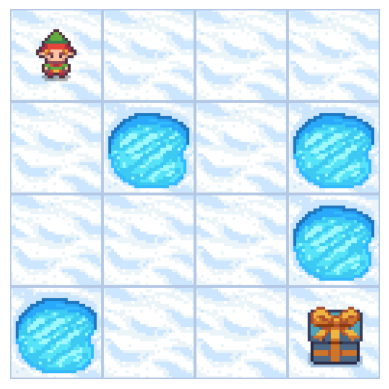

c:\Users\danie\Documents\GitHub\Woolf\Tier_2\02_numerical_programming\.venv\Lib\site-packages\gym\utils\passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):


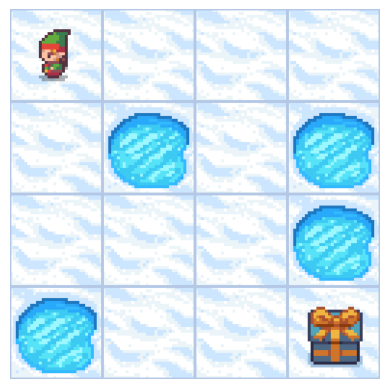

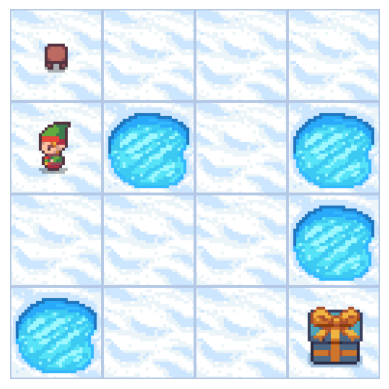

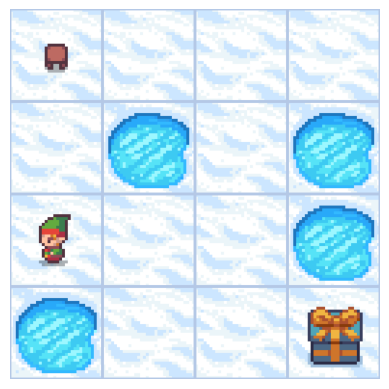

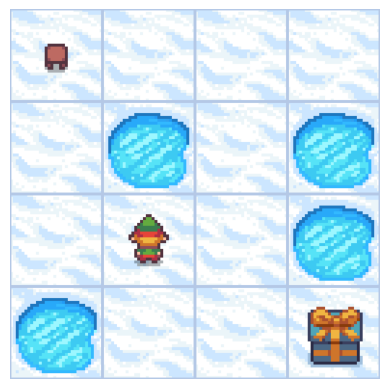

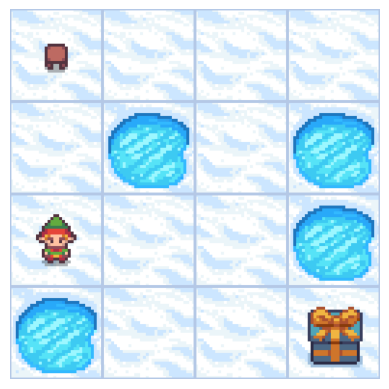

...

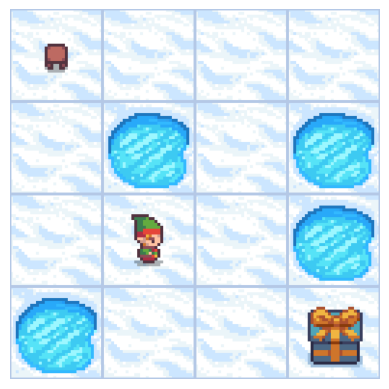

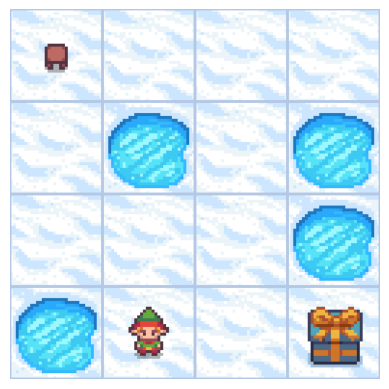

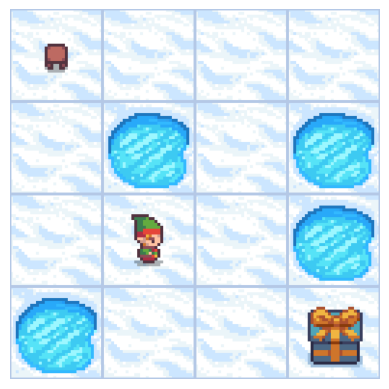

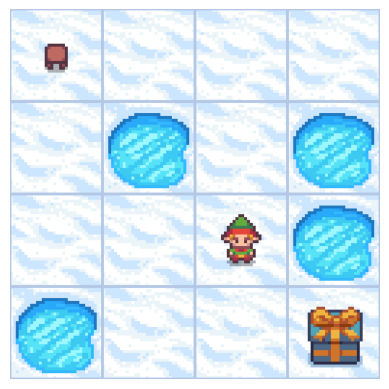

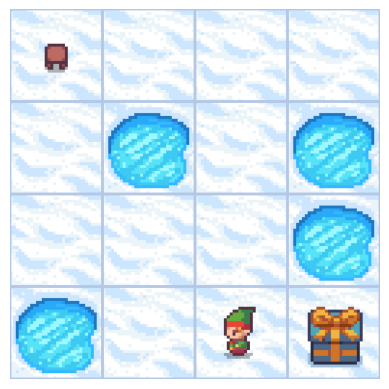

In [26]:
optimal_policy = policy_iteration()

print("Optimal policy (probabilities of actions in each state):")
print(optimal_policy)

# Demonstration of optimal policy execution with visualization
state = env.reset()[0]  # Extract the state from the returned tuple
done = False
while not done:
    img = env.render()  # Get an image of the current state
    show_render(img)

    action = int(optimal_policy[state])  # Choose an action according to the policy
    state, reward, done, truncated, info = env.step(action)